In [1]:
import os
import glob
import numpy as np
import matplotlib.pyplot as plt



In [2]:
#read data from latest file
list_of_files = glob.glob('/logs/*')
file = max(list_of_files, key=os.path.getctime)
print('reading file: '+file)

# '%u64\t%u\t%u\t%u\t%u\t%f\t%f\t%d\t%f\t%f\t%f'
ns = [np.uint64(x.split('\t')[0]) for x in open(file).readlines()]
curr_type = [np.uint32(x.split('\t')[1]) for x in open(file).readlines()]
loop_cnt = [np.uint32(x.split('\t')[2]) for x in open(file).readlines()]
step_cnt = [np.uint32(x.split('\t')[3]) for x in open(file).readlines()]
trj_cnt = [np.uint32(x.split('\t')[4]) for x in open(file).readlines()]
ph_angle = [float(x.split('\t')[5]) for x in open(file).readlines()]
i_q = [float(x.split('\t')[6]) for x in open(file).readlines()]
motor_vel = [np.int16(x.split('\t')[7]) for x in open(file).readlines()]
motor_pos = [float(x.split('\t')[8]) for x in open(file).readlines()]
link_pos = [float(x.split('\t')[9]) for x in open(file).readlines()]
aux_var = [float(x.split('\t')[10]) for x in open(file).readlines()]

#find where we start testing id instead of iq 
cc = len(curr_type)-2
for i in range(1,len(curr_type)):
    if (curr_type[i] != curr_type[i - 1]):
        # disp('found change of current curr_type')
        cc = i
        break

reading file: /logs/20200917163853-phase_calib_free.log


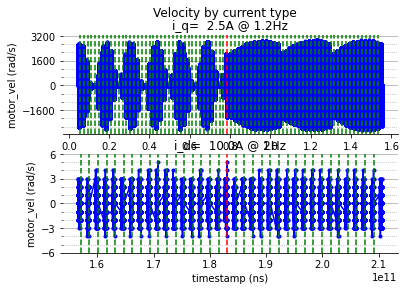

In [10]:
#Plot full test
fig, axs = plt.subplots(2)
fig.suptitle('Velocity by current type')

axs[0].plot(ns[:cc], motor_vel[:cc], label='Motor Vel', color='b',marker='.')
for i in range(1,cc):
    if (loop_cnt[i] > loop_cnt[i-1]):
        axs[0].axvline(ns[i-1],linestyle='--', color='r')
    elif (step_cnt[i] > step_cnt[i-1]):
        axs[0].axvline(ns[i-1],linestyle='--', color='g')
axs[0].set_title('i_q=  2.5A @ 1.2Hz')
axs[0].set_ylabel('motor_vel (rad/s)')
axs[0].set_xlabel('timestamp (ns)')
axs[0].grid(b=True, which='major',axis='y', linestyle='-')
axs[0].grid(b=True, which='minor',axis='y', linestyle=':')
axs[0].yaxis.set_major_locator(plt.MultipleLocator((max(motor_vel) - min(motor_vel))*1.1 / 4))
axs[0].yaxis.set_minor_locator(plt.MultipleLocator((max(motor_vel) - min(motor_vel))*1.1 / 12))
axs[0].spines['top'].set_visible(False)
axs[0].spines['right'].set_visible(False)
axs[0].spines['left'].set_visible(False)

axs[1].plot(ns[cc:], motor_vel[cc:], label='Motor Vel', color='b',marker='.')
for i in range(cc,len(ns)):
    if (loop_cnt[i] > loop_cnt[i-1]):
        axs[1].axvline(ns[i-1],linestyle='--', color='r')
    elif (step_cnt[i] > step_cnt[i-1]):
        axs[1].axvline(ns[i-1],linestyle='--', color='g')
plt_max=max([ max(motor_vel[cc:]) , -min(motor_vel[cc:]) ])*1.2
axs[1].set_ylim(-plt_max,plt_max)
axs[1].set_title('i_d=  10.0A @ 2Hz')
axs[1].set_ylabel('motor_vel (rad/s)')
axs[1].set_xlabel('timestamp (ns)')
axs[1].grid(b=True, which='major',axis='y', linestyle='-')
axs[1].grid(b=True, which='minor',axis='y', linestyle=':')
axs[1].yaxis.set_major_locator(plt.MultipleLocator(plt_max / 2))
axs[1].yaxis.set_minor_locator(plt.MultipleLocator(plt_max / 6))
axs[1].spines['top'].set_visible(False)
axs[1].spines['right'].set_visible(False)
axs[1].spines['left'].set_visible(False)
plt.show()

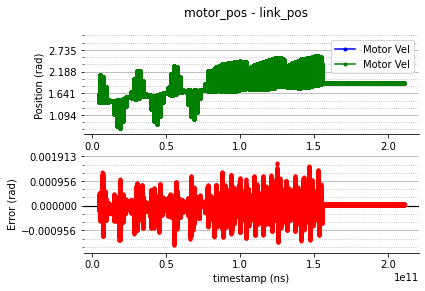

In [4]:
#Plot position
fig, axs = plt.subplots(2)
fig.suptitle('Full test position')

axs[0].plot(ns, motor_pos, label='Motor Vel', color='b',marker='.')
axs[0].plot(ns, link_pos, label='Motor Vel', color='g',marker='.')
axs[0].set_ylabel('Position (rad)')
axs[0].set_xlabel('timestamp (ns)')
#axs[0].grid(b=True, which='major',axis='y', linestyle='-')
axs[0].grid(b=True, which='minor',axis='y', linestyle='--')
axs[0].legend()

axs[0].set_ylim(min(link_pos)*0.8, max(link_pos)*1.2)
axs[0].grid(b=True, which='major',axis='y', linestyle='-')
axs[0].grid(b=True, which='minor',axis='y', linestyle=':')
axs[0].yaxis.set_major_locator(plt.MultipleLocator((max(motor_pos) - min(motor_pos))*1.2 / 4))
axs[0].yaxis.set_minor_locator(plt.MultipleLocator((max(motor_pos) - min(motor_pos))*1.2 / 12))
axs[0].spines['top'].set_visible(False)
axs[0].spines['right'].set_visible(False)
axs[0].spines['left'].set_visible(False)


fig.suptitle('motor_pos - link_pos')
diff = [motor_pos[i]-link_pos[i] for i in range(0,len(motor_pos))]

axs[1].axhline(0, color='black', lw=1.2)
axs[1].plot(ns, diff, label='diff', color='r',marker='.')
axs[1].set_ylabel('Error (rad)')
axs[1].set_xlabel('timestamp (ns)')
axs[1].grid(b=True, which='major',axis='y', linestyle='-')
axs[1].grid(b=True, which='minor',axis='y', linestyle='--')

axs[1].set_ylim(min(diff)*1.2, max(diff)*1.2)
axs[1].grid(b=True, which='major',axis='y', linestyle='-')
axs[1].grid(b=True, which='minor',axis='y', linestyle=':')
axs[1].yaxis.set_major_locator(plt.MultipleLocator((max(diff) - min(diff))*1.2 / 4))
axs[1].yaxis.set_minor_locator(plt.MultipleLocator((max(diff) - min(diff))*1.2 / 12))
axs[1].spines['top'].set_visible(False)
axs[1].spines['right'].set_visible(False)
axs[1].spines['left'].set_visible(False)
#axs.legend()
plt.show()

In [5]:
# split trajectories in individual motions
trj_v = [i for i in range(0,len(trj_cnt)) if (trj_cnt[i]==0 and curr_type[i] ==0)]
for i in range(trj_v[-1],len(curr_type)):
    if curr_type[i] != curr_type[i-1]:
        trj_v.append(i)
        break

phase = [ ph_angle[i] for i in range(0,len(ph_angle)-1) if (ph_angle[i] != ph_angle[i+1]) ]
phase.append(ph_angle[-2])

ts = [[ s-ns[trj_v[j-1]] for s in ns[trj_v[j-1]:trj_v[j]] ] for j in range(1,len(trj_v)) ]
steps = [[ v for v in motor_vel[trj_v[j-1]:trj_v[j]] ] for j in range(1,len(trj_v)) ]

alpha=0.1
smooth=steps
for i in range(0,len(steps)):
    for j in range(1,len(steps[i])):
        smooth[i][j]=alpha*steps[i][j] + (1-alpha)*smooth[i][j-1]


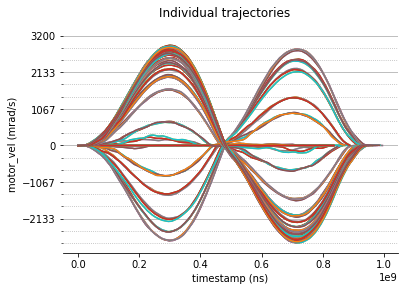

In [6]:
#Plot individual trajectories
fig, axs = plt.subplots()
fig.suptitle('Individual trajectories')
for i in range(0,len(ts)):
    axs.plot(ts[i], steps[i], label='diff')
    axs.plot(ts[i], smooth[i], label='diff')

axs.set_ylabel('motor_vel (mrad/s)')
axs.set_xlabel('timestamp (ns)')

axs.grid(b=True, which='major',axis='y', linestyle='-')
axs.grid(b=True, which='minor',axis='y', linestyle=':')
axs.yaxis.set_major_locator(plt.MultipleLocator((max(motor_vel) - min(motor_vel))*1.1 / 6))
axs.yaxis.set_minor_locator(plt.MultipleLocator((max(motor_vel) - min(motor_vel))*1.1 / 18))
axs.spines['top'].set_visible(False)
axs.spines['right'].set_visible(False)
axs.spines['left'].set_visible(False)

plt.show()

In [7]:
score=[[],[],[]]
for i in range(0,len(steps)):
    score[0].append(phase[i])
    tmp = sum(steps[i][0:int(len(steps[i])/2)])
    if tmp > 0:
        score[1].append(  (max(  steps[i][:]) - min(  steps[i][:])) /2 )
        score[2].append(  (max( smooth[i][:]) - min( smooth[i][:])) /2 )
    else:
        score[1].append( -(max(  steps[i][:]) - min(  steps[i][:])) /2 )
        score[2].append( -(max( smooth[i][:]) - min( smooth[i][:])) /2 )


In [8]:
REPEAT_COST = 3
STEP_1 = 13
STEP_2 = 13
BASE2 = STEP_1*REPEAT_COST

keys_1   = phase[      :       STEP_1]
keys_2   = phase[BASE2 : BASE2+STEP_2]

_phase=[]
vals_1 = []
for i in range(0,STEP_1):
    _phase.append(phase[i])
    i1 = score[1][i]
    i2 = score[1][i+STEP_1]
    i3 = score[1][i+STEP_1*2]
    vals_1.append((i1+i2+i3)/3)
 
vals_2 = []
for i in range(BASE2,BASE2+STEP_2):
    _phase.append(phase[i])
    i1 = score[1][i]
    i2 = score[1][i+STEP_2]
    i3 = score[1][i+STEP_2*2]
    vals_2.append((i1+i2+i3)/3)



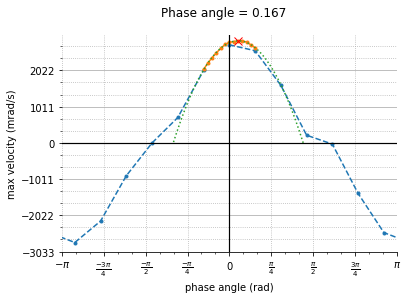

Result: ph_angle = 0.16679938272113848


In [17]:
import plot_utils
#Fit 2nd order polinomial and plot max vs phase
fig, axs = plt.subplots()

l1= axs.plot(keys_1,vals_1, color='#1f77b4', marker='.', linestyle='--')
axs.plot(keys_2,vals_2, color='#ff7f0e', marker='.', linestyle='-')


keys_1s=[v-2*np.pi for v in keys_1]
keys_2s=[v-2*np.pi for v in keys_2]
l2= axs.plot(keys_1s,vals_1, color='#1f77b4', marker='.', linestyle='--')
axs.plot(keys_2s,vals_2, color='#ff7f0e', marker='.', linestyle='-')

z1 = np.polyfit(keys_2, vals_2, 2)
z2 = np.polyfit(keys_2s, vals_2, 2)
p1 = np.poly1d(z1)
p2 = np.poly1d(z2)
x1 = np.linspace(p1.roots[0],p1.roots[1],1000)
x2 = np.linspace(p2.roots[0],p2.roots[1],1000)

axs.plot(x1,p1(x1),color='#2ca02c', linestyle=':')
axs.plot(x2,p2(x2),color='#2ca02c', linestyle=':')

#find best
fit_angle = p1.deriv().roots[0]
if fit_angle <= 2*np.pi:
    axs.set_xlim(0,2*np.pi)
    l3 =axs.plot(fit_angle,p1(fit_angle),color='r', marker='x')
else:
    fit_angle = fit_angle -2*np.pi
    axs.set_xlim(-np.pi,np.pi)
    l3 =axs.plot(fit_angle,p2(fit_angle),color='r', marker='x', markersize=7.5)

# make plot pretty
fig.suptitle('Phase angle = {:.3f}'.format(fit_angle))
axs.set_ylabel('max velocity (mrad/s)')
axs.set_xlabel('phase angle (rad)')
axs.grid(b=True, which='major',axis='x', linestyle=':')
axs.grid(b=True, which='major',axis='y', linestyle='-')
axs.grid(b=True, which='minor',axis='y', linestyle=':')

axs.axvline(0, color='black', lw=1.2)
axs.set_ylim(min(vals_1)*1.1, max(vals_1)*1.1)
axs.yaxis.set_major_locator(plt.MultipleLocator((max(vals_1) - min(vals_1))*1.1 / 6))
axs.yaxis.set_minor_locator(plt.MultipleLocator((max(vals_1) - min(vals_1))*1.1 / 18))

#axs.set_xlim(0,2*np.pi)
axs.axhline(0, color='black', lw=1.2)
axs.xaxis.set_major_locator(plt.MultipleLocator(np.pi / 4))
axs.xaxis.set_minor_locator(plt.MultipleLocator(np.pi / 12))
axs.xaxis.set_major_formatter(plt.FuncFormatter(plot_utils.multiple_formatter(denominator=4,number=np.pi, latex='\pi')))

axs.spines['top'].set_visible(False)
axs.spines['right'].set_visible(False)
axs.spines['left'].set_visible(False)
plt.show()

print('Result: ph_angle = '+str(fit_angle))
